### Imports

In [6]:
import os
import numpy as np
import pandas as pd
import librosa
import librosa.display
import matplotlib.pyplot as plt
import os
import numpy as np
import glob
import IPython.display as ipd

# Accessing CSV files

In [ ]:
# test

In [2]:
import pandas as pd

# Caminhos dos arquivos CSV
train_metadata_path = '/workspace/aimsbirdclef/input/birdclef-2024/train_metadata.csv'
sample_submission_path = '/workspace/aimsbirdclef/input/birdclef-2024/sample_submission.csv'
eBird_taxonomy_path = '/workspace/aimsbirdclef/input/birdclef-2024/eBird_Taxonomy_v2021.csv'

# Carregar os arquivos CSV em DataFrames
train_metadata_df = pd.read_csv(train_metadata_path)
sample_submission_df = pd.read_csv(sample_submission_path)
eBird_taxonomy_df = pd.read_csv(eBird_taxonomy_path)

In [3]:
train_metadata_df

,primary_label,secondary_labels,type,latitude,longitude,scientific_name,common_name,author,license,rating,url,filename
0,asbfly,[],['call'],39.2297,118.1987,Muscicapa dauurica,Asian Brown Flycatcher,Matt Slaymaker,Creative Commons Attribution-NonCommercial-Sha...,5.0,https://www.xeno-canto.org/134896,asbfly/XC134896.ogg
1,asbfly,[],['song'],51.4030,104.6401,Muscicapa dauurica,Asian Brown Flycatcher,Magnus Hellström,Creative Commons Attribution-NonCommercial-Sha...,2.5,https://www.xeno-canto.org/164848,asbfly/XC164848.ogg
2,asbfly,[],['song'],36.3319,127.3555,Muscicapa dauurica,Asian Brown Flycatcher,Stuart Fisher,Creative Commons Attribution-NonCommercial-Sha...,2.5,https://www.xeno-canto.org/175797,asbfly/XC175797.ogg
3,asbfly,[],['call'],21.1697,70.6005,Muscicapa dauurica,Asian Brown Flycatcher,vir joshi,Creative Commons Attribution-NonCommercial-Sha...,4.0,https://www.xeno-canto.org/207738,asbfly/XC207738.ogg
4,asbfly,[],['call'],15.5442,73.7733,Muscicapa dauurica,Asian Brown Flycatcher,Albert Lastukhin & Sergei Karpeev,Creative Commons Attribution-NonCommercial-Sha...,4.0,https://www.xeno-canto.org/209218,asbfly/XC209218.ogg
...,...,...,...,...,...,...,...,...,...,...,...,...
24454,zitcis1,[],[''],43.5925,4.5434,Cisticola juncidis,Zitting Cisticola,Chèvremont Fabian,Creative Commons Attribution-NonCommercial-Sha...,5.0,https://xeno-canto.org/845747,zitcis1/XC845747.ogg
24455,zitcis1,[],[''],43.5925,4.5434,Cisticola juncidis,Zitting Cisticola,Chèvremont Fabian,Creative Commons Attribution-NonCommercial-Sha...,4.0,https://xeno-canto.org/845817,zitcis1/XC845817.ogg
24456,zitcis1,[],[''],51.1207,4.5607,Cisticola juncidis,Zitting Cisticola,Wim Jacobs,Creative Commons Attribution-NonCommercial-Sha...,4.0,https://xeno-canto.org/856176,zitcis1/XC856176.ogg
24457,zitcis1,[],[''],41.5607,-8.4236,Cisticola juncidis,Zitting Cisticola,Jorge Leitão,Creative Commons Attribution-NonCommercial-Sha...,4.5,https://xeno-canto.org/856723,zitcis1/XC856723.ogg


In [4]:
sample_submission_df

,row_id,asbfly,ashdro1,ashpri1,ashwoo2,asikoe2,asiope1,aspfly1,aspswi1,barfly1,...,whbwoo2,whcbar1,whiter2,whrmun,whtkin2,woosan,wynlau1,yebbab1,yebbul3,zitcis1
0,soundscape_1446779_5,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,...,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495
1,soundscape_1446779_10,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,...,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495
2,soundscape_1446779_15,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,...,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495,0.005495


In [5]:
eBird_taxonomy_df

,TAXON_ORDER,CATEGORY,SPECIES_CODE,PRIMARY_COM_NAME,SCI_NAME,ORDER1,FAMILY,SPECIES_GROUP,REPORT_AS
0,1,species,ostric2,Common Ostrich,Struthio camelus,Struthioniformes,Struthionidae (Ostriches),Ostriches,NaN
1,6,species,ostric3,Somali Ostrich,Struthio molybdophanes,Struthioniformes,Struthionidae (Ostriches),NaN,NaN
2,7,slash,y00934,Common/Somali Ostrich,Struthio camelus/molybdophanes,Struthioniformes,Struthionidae (Ostriches),NaN,NaN
3,8,species,grerhe1,Greater Rhea,Rhea americana,Rheiformes,Rheidae (Rheas),Rheas,NaN
4,14,species,lesrhe2,Lesser Rhea,Rhea pennata,Rheiformes,Rheidae (Rheas),NaN,NaN
...,...,...,...,...,...,...,...,...,...
16748,34694,species,slcgro1,Slate-colored Grosbeak,Saltator grossus,Passeriformes,Thraupidae (Tanagers and Allies),NaN,NaN
16749,34697,species,bltgro2,Black-throated Grosbeak,Saltator fuliginosus,Passeriformes,Thraupidae (Tanagers and Allies),NaN,NaN
16750,34698,spuh,saltat1,saltator sp.,Saltator sp.,Passeriformes,Thraupidae (Tanagers and Allies),NaN,NaN
16751,34699,spuh,passer1,passerine sp.,Passeriformes sp.,Passeriformes,NaN,Others,NaN


# Spectral Centroid

In [19]:
def load_audio(audio_path, sample_rate=None):
    """
    Load an audio file using librosa.
    
    Args:
    audio_path (str): Path to the audio file.
    sample_rate (int, optional): Sampling rate to use for loading the audio. Default is None, which keeps the original sampling rate.
    
    Returns:
    tuple: audio time series (numpy array) and sampling rate (int)
    """
    y, sr = librosa.load(audio_path, sr=sample_rate)
    return y, sr

def generate_mel_spectrogram(y, sr, n_mels=128):
    """
    Generate a Mel spectrogram from an audio time series.
    
    Args:
    y (numpy array): Audio time series.
    sr (int): Sampling rate.
    n_mels (int): Number of Mel bands to generate.
    
    Returns:
    numpy array: Mel-scaled spectrogram.
    """
    S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels=n_mels)
    log_S = librosa.power_to_db(S, ref=np.max)
    return log_S

def generate_linear_spectrogram(y, sr, n_fft=2048, hop_length=512):
    """
    Generate a spectrogram with a linear frequency scale from an audio time series.
    
    Args:
    y (numpy array): Audio time series.
    sr (int): Sampling rate.
    n_fft (int): Length of the FFT window.
    hop_length (int): Number of samples between successive frames.
    
    Returns:
    tuple: numpy array of the spectrogram (magnitude), frequency array, and time array.
    """
    D = np.abs(librosa.stft(y, n_fft=n_fft, hop_length=hop_length))
    log_D = librosa.amplitude_to_db(D, ref=np.max)
    return log_D

def plot_spectrogram(log_S, sr, mel=True, title='Spectrogram', figsize=(10, 4), extra_plots=None):
    """
    Plot a spectrogram, either Mel or linear frequency scale, and optionally additional plots.
    
    Args:
    log_S (numpy array): Log-scaled spectrogram.
    sr (int): Sampling rate.
    mel (bool): If True, plot Mel spectrogram, otherwise plot linear frequency scale.
    title (str): Title of the plot.
    figsize (tuple): Figure dimension in inches.
    extra_plots (list of dicts): Additional plots to overlay, each dict must have 'x' and 'y' and optional 'label' and 'color'.
    """
    plt.figure(figsize=figsize)
    ax = plt.subplot(1, 1, 1)
    if mel:
        librosa.display.specshow(log_S, sr=sr, x_axis='time', y_axis='mel', ax=ax)
    else:
        librosa.display.specshow(log_S, sr=sr, x_axis='time', y_axis='linear', ax=ax)
    plt.title(title)
    plt.colorbar(format='%+02.0f dB', ax=ax)

    # Plot additional lines if any
    if extra_plots is not None:
        for plot in extra_plots:
            plt.plot(plot['x'], plot['y'], label=plot.get('label', None), color=plot.get('color', 'cyan'))
        plt.legend(loc='upper right')

    plt.tight_layout()
    plt.show()
  
def plot_spectral_centroid(audio_path):
    """
    Calculate the spectral centroid and plot it on the spectrogram of the audio using the plot_spectrogram function.

    Args:
    audio_path (str): Path to the audio file.
    """
    # Load the audio file
    y, sr = librosa.load(audio_path, sr=None)  # Load with native sampling rate

    # Compute the Mel spectrogram
    dB = generate_mel_spectrogram(y, sr)

    # Compute the spectral centroid
    spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)[0]
    frames = range(len(spectral_centroid))
    t = librosa.frames_to_time(frames, sr=sr)

    # Prepare the additional plot data for the spectral centroid
    extra_plots = [{'x': t, 'y': spectral_centroid, 'label': 'Spectral Centroid', 'color': 'cyan'}]

    # Call the plot_spectrogram function
    plot_spectrogram(dB, sr, mel=True, title='Spectrogram with Spectral Centroid', extra_plots=extra_plots)

RuntimeError: No mappable was found to use for colorbar creation. First define a mappable such as an image (with imshow) or a contour set (with contourf).

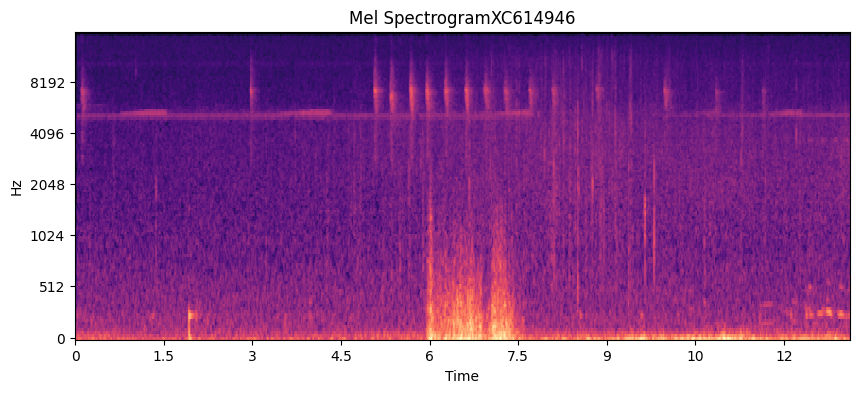

In [20]:
audio_sample_path = '/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1/XC614946.ogg'
y_sample, sr_sample = load_audio(audio_sample_path)
log_S_mel = generate_mel_spectrogram(y_sample, sr_sample)
log_D= generate_linear_spectrogram(y_sample, sr_sample)

plot_spectrogram(log_S_mel, sr_sample, mel=True, title='Mel Spectrogram'+audio_sample_path.split('/')[-1].split('.')[0])
plot_spectral_centroid(audio_sample_path)
ipd.Audio(data=y_sample, rate=sr_sample)

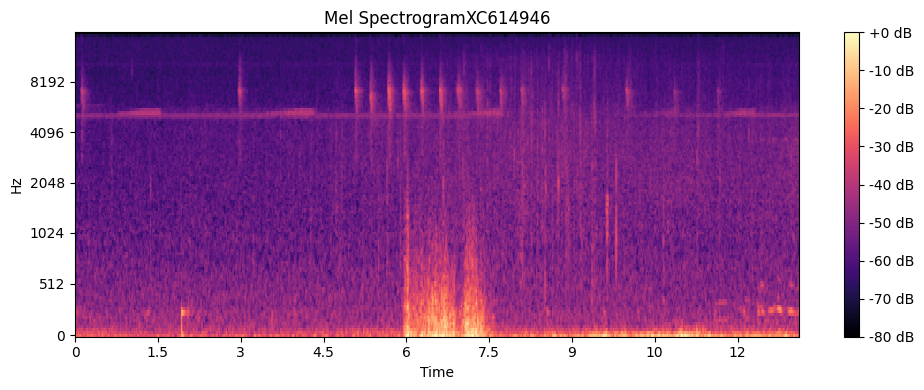

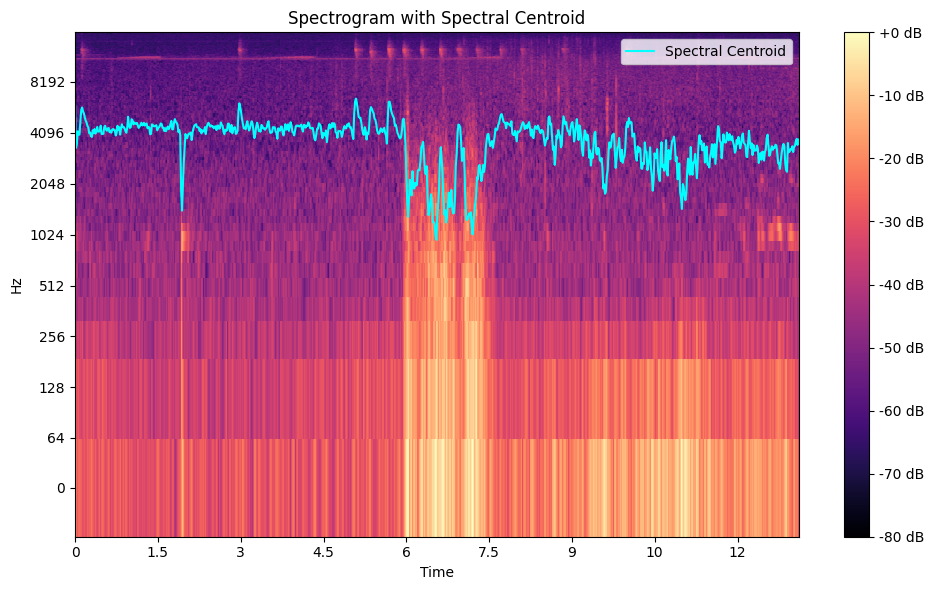

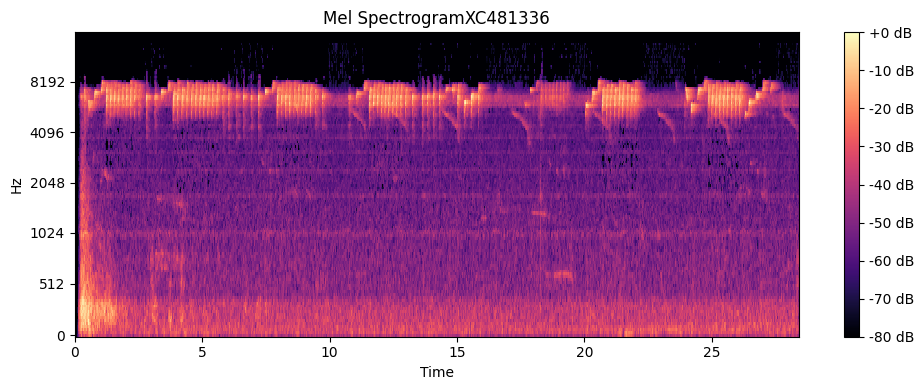

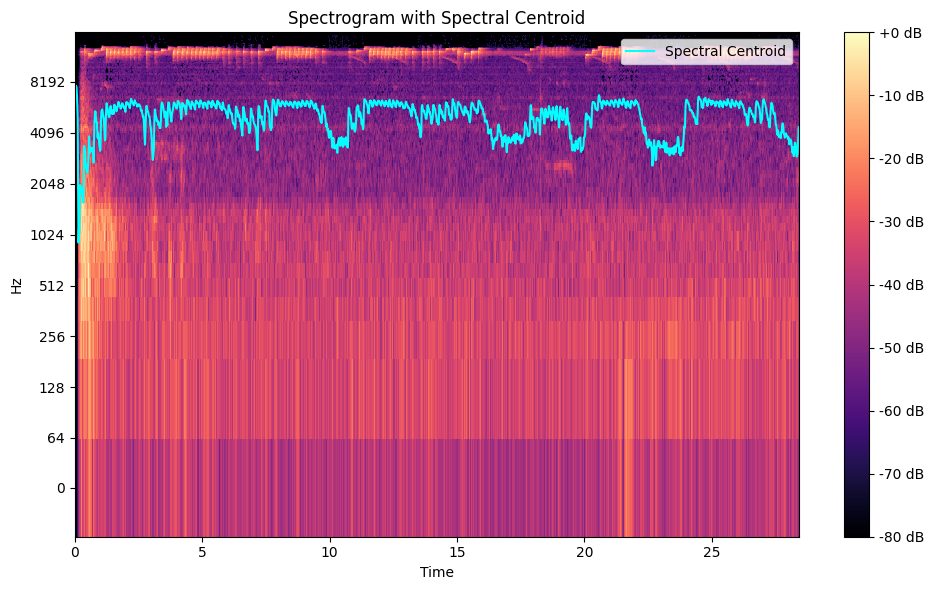

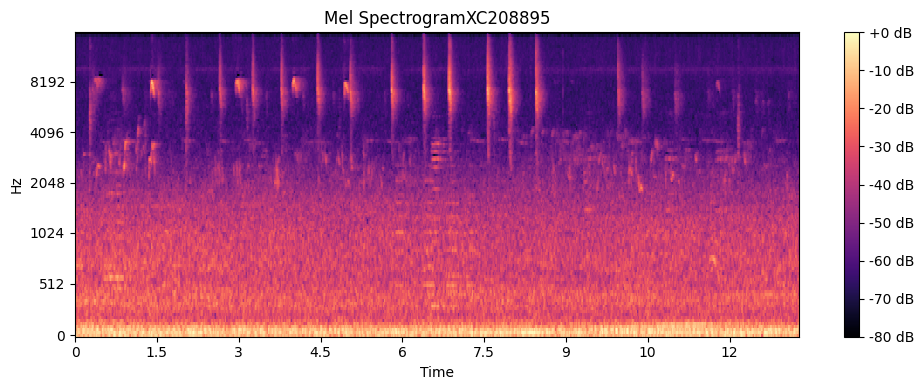

...

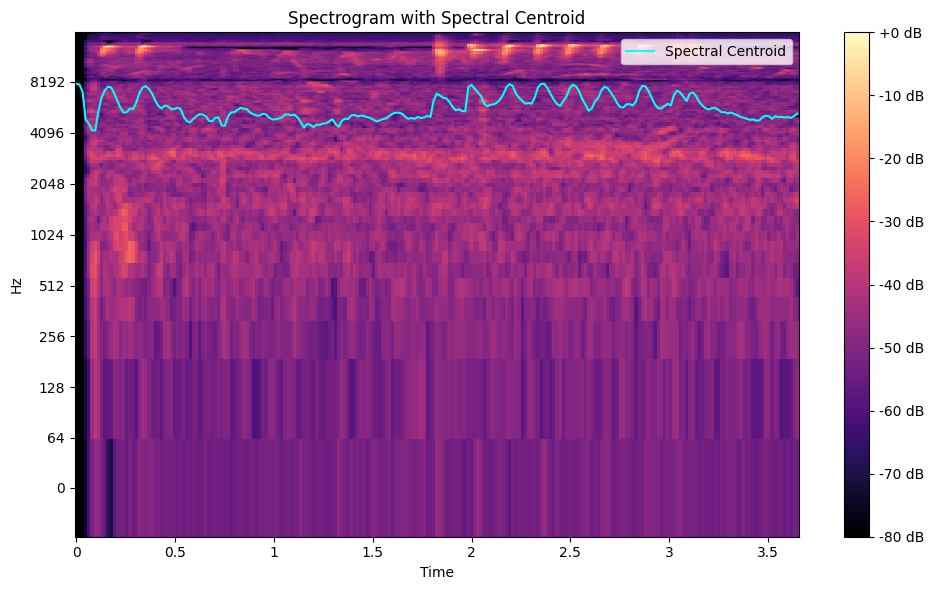

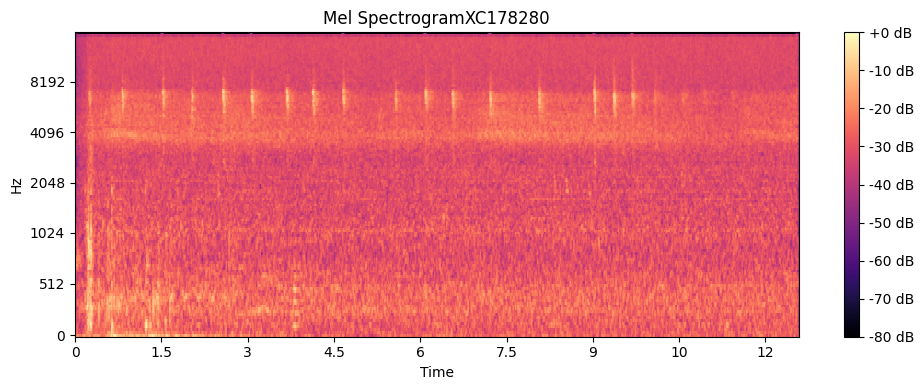

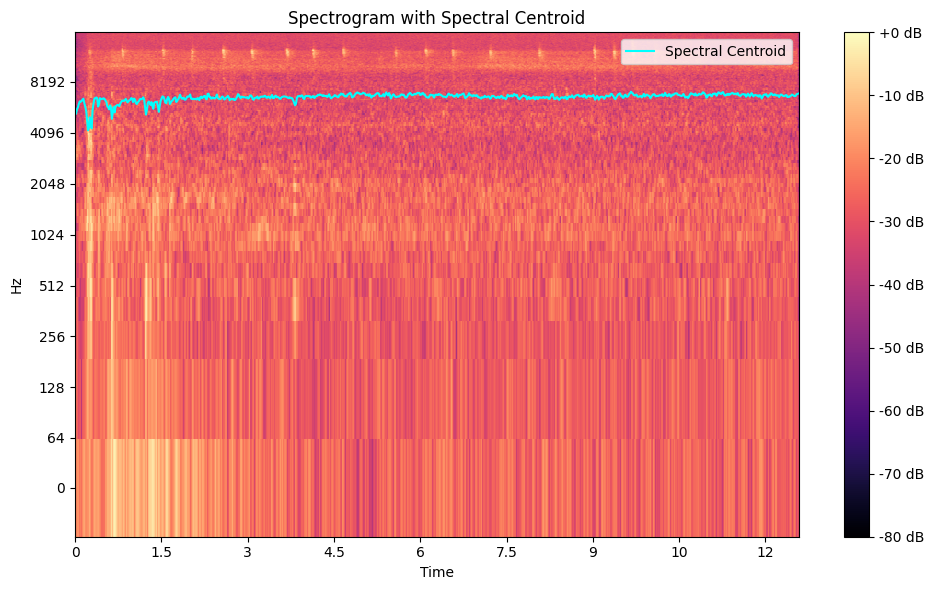

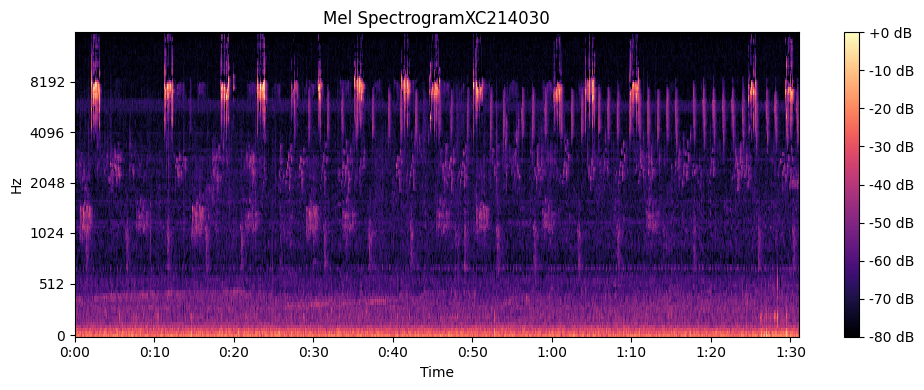

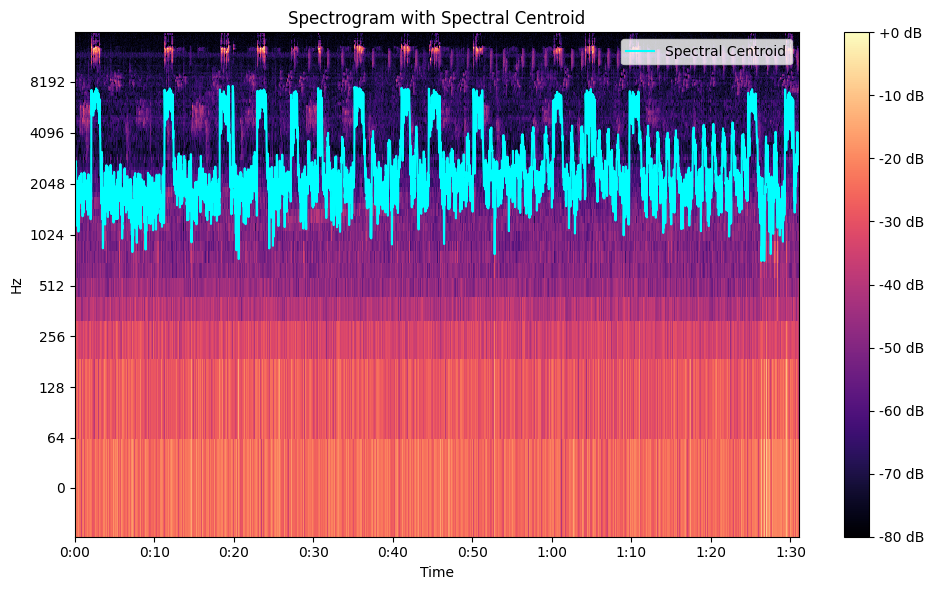

In [12]:
for audio_sample_path in glob.glob('/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1/*'):
    #audio_sample_path = '/workspace/aimsbirdclef/input/birdclef-2024/train_audio/tibfly3/XC19882.ogg'
    y_sample, sr_sample = load_audio(audio_sample_path)
    log_S_mel = generate_mel_spectrogram(y_sample, sr_sample)
    log_D= generate_linear_spectrogram(y_sample, sr_sample)

    plot_spectrogram(log_S_mel, sr_sample, mel=True, title='Mel Spectrogram ' + audio_sample_path.split('/')[-1].split('.')[0])
    plot_spectral_centroid(audio_sample_path)
    ipd.Audio(data=y_sample, rate=sr_sample)

# Lendo audios

In [ ]:
y, sr = librosa.load('/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1/XC19882.ogg', sr=None)
D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)

In [113]:
def get_audio_files(folder_path):
    """Obtém os caminhos dos arquivos de áudio .ogg na pasta especificada."""
    audio_files = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.endswith('.ogg'):
                file_path = os.path.join(root, file)
                audio_files.append(file_path)
    return audio_files

def calculate_spectrograms(audio_files, center_audio=False, center_seconds=10):
    spectrograms = []
    
    for audio in audio_files:
        y, sr = librosa.load(audio, sr=None)
        
        if center_audio:
            num_samples_center = min(center_seconds * sr, len(y))  # Garante que não ultrapasse o tamanho do áudio
            start_sample = (len(y) - num_samples_center) // 2
            end_sample = start_sample + num_samples_center
            y_center = y[start_sample:end_sample]
            D_center = librosa.amplitude_to_db(librosa.stft(y_center, window_size=2048, hop_length=512), ref=np.max)
            spectrograms.append((y_center, sr, D_center))
        else:
            D = librosa.amplitude_to_db(librosa.stft(y, window_size=2048, hop_length=512), ref=np.max)
            spectrograms.append((y, sr, D))
    
    return spectrograms

def calculate_energy(y):
    """Calcula a energia do sinal de áudio."""
    energy = np.sum(np.square(y))
    return energy


def plot_spectrograms(spectrograms, audio_files):
    """Plota os espectrogramas."""
    num_files = len(spectrograms)
    
    # Define o número de colunas e linhas para os subplots
    cols = 3
    rows = (num_files + 2) // cols
    
    plt.figure(figsize=(20, 5 * rows))
    
    for idx, (y, sr, D), audio_file in zip(range(1, num_files + 1), spectrograms, audio_files):
        plt.subplot(rows, cols, idx)
        
        # Plot do espectrograma
        img = librosa.display.specshow(D, sr=sr, x_axis='time', y_axis='log')
        plt.colorbar(format='%+2.0f dB')
        
        # Obtém o nome da amostra de áudio e o nome da pasta
        sample_name = os.path.basename(audio_file)
        folder_name = os.path.basename(os.path.dirname(audio_file))
        
        plt.title(f'{folder_name} - {sample_name.split(".")[0]} - Energy: {calculate_energy(y):.2f}')
        plt.xlabel('Tempo (s)')
        plt.ylabel('Frequência (Hz)')
        
    plt.tight_layout()
    plt.show()


In [114]:
y, sr = librosa.load("/workspace/aimsbirdclef/input/birdclef-2024/train_audio/wynlau1/XC197252.ogg", sr=None)
print(y)
print(len(y)/sr)
print(sr)

[-3.7903790e-06  4.5045385e-07 -1.0247281e-06 ... -2.9950522e-04
 -6.1570812e-04 -4.3932823e-04]
103.26203125
32000


/tmp/ipykernel_91924/4032627718.py:22: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D_center = librosa.amplitude_to_db(librosa.stft(y_center), ref=np.max)


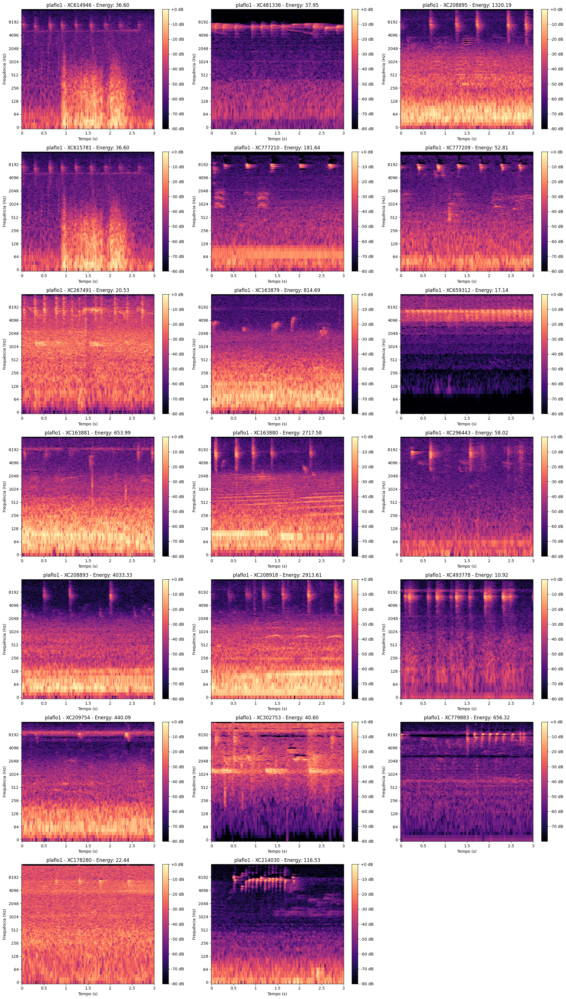

In [116]:
# Pasta dos áudios
folder_path = '/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1'
 
# Obter os caminhos dos arquivos de áudio
audio_files = get_audio_files(folder_path)

# Calcular os espectrogramas
spectrograms = calculate_spectrograms(audio_files, center_audio = True, center_seconds=3)

# Plotar os espectrogramas
plot_spectrograms(spectrograms, audio_files)

In [160]:
import librosa
import numpy as np

# Carregar o áudio
y, sr = librosa.load('/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1/XC659312.ogg', sr=None)

# Calcular o espectrograma com janelamento fixo
S = librosa.stft(y, n_fft=2048, hop_length=512)
magnitude, phase = librosa.magphase(S)
D = librosa.amplitude_to_db(magnitude, ref=np.max)

circle_center = []

# Iterar sobre os tempos (colunas de D)
for time in range(D.shape[1]):
    max_intensity_idx = np.unravel_index(np.argmax(D[:, time]), D.shape)
    circle_center.append([max_intensity_idx[1], max_intensity_idx[0]])

print(circle_center[0])

max_intensity_idx = np.unravel_index(np.argmax(D), D.shape)
circle_center = (max_intensity_idx[1], max_intensity_idx[0])  # Invertendo as coordenadas para (x, y)
print(circle_center)

[402, 0]
(300, 424)


Áudio Original:


/tmp/ipykernel_91924/3896926375.py:13: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


Áudio com Máscara:


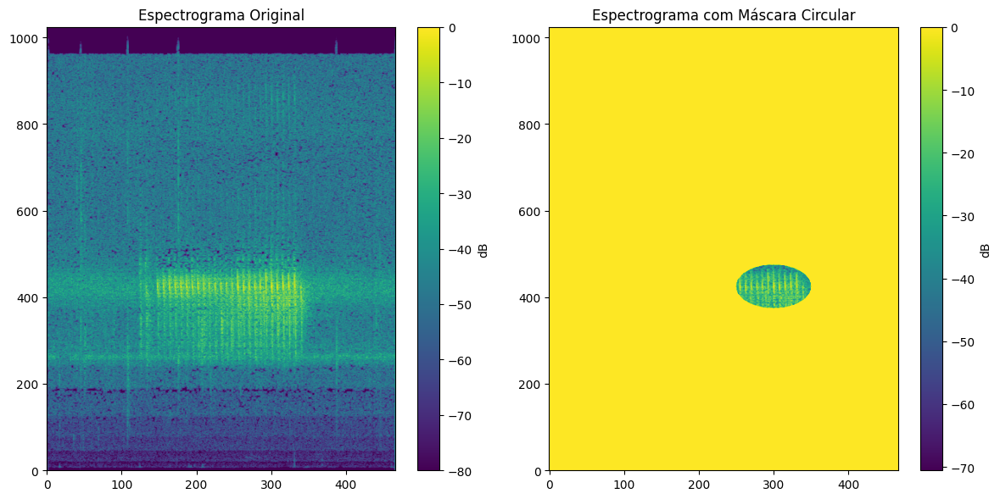

In [164]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio, display

def load_audio(audio_file):
    """Carrega um arquivo de áudio e retorna o sinal e a taxa de amostragem."""
    y, sr = librosa.load(audio_file, sr=None)
    return y, sr

def calculate_spectrogram(y):
    """Calcula o espectrograma de um sinal de áudio."""
    D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
    return D

def find_max_intensity_point(D):
    """Encontra o ponto de maior intensidade em um espectrograma."""
    max_intensity_idx = np.unravel_index(np.argmax(D), D.shape)
    circle_center = (max_intensity_idx[1], max_intensity_idx[0])  # Invertendo as coordenadas para (x, y)
    return circle_center

def create_circle_mask(shape, center, radius):
    """Cria uma máscara circular."""
    rows, cols = shape
    Y, X = np.ogrid[:rows, :cols]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y - center[1])**2)
    mask = dist_from_center <= radius
    return mask

def apply_circle_mask_to_spectrogram(D, circle_center, circle_radius):
    """Aplica uma máscara circular ao espectrograma."""
    mask = create_circle_mask(D.shape, circle_center, circle_radius)
    D_masked = D * mask
    return D_masked

def play_audio(y, sr):
    """Reproduz um sinal de áudio."""
    display(Audio(data=y, rate=sr))

def plot_spectrograms(D, D_masked):
    """Plota o espectrograma original e o espectrograma com a máscara."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title('Espectrograma Original')
    plt.imshow(D, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.subplot(1, 2, 2)
    plt.title('Espectrograma com Máscara Circular')
    plt.imshow(D_masked, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.tight_layout()
    plt.show()

# Caminho do arquivo de áudio
audio_file = '/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1/XC659312.ogg'

# Carregar o áudio
y, sr = load_audio(audio_file)

# Calcular o espectrograma
D = calculate_spectrogram(y)

# Encontrar o ponto de maior intensidade
circle_center = find_max_intensity_point(D)

# Definir o raio do círculo
circle_radius = 50

# Aplicar a máscara circular
D_masked = apply_circle_mask_to_spectrogram(D, circle_center, circle_radius)

# Reproduzir o áudio original
print("Áudio Original:")
play_audio(y, sr)

# Reproduzir o áudio com a máscara
y_masked = librosa.istft(librosa.db_to_amplitude(D_masked))
print("Áudio com Máscara:")
play_audio(y_masked, sr)

# Plotar os espectrogramas
plot_spectrograms(D, D_masked)


[[300, 424], [300, 424], [300, 424], [300, 424], [300, 424], [300, 424], [300, 424], [300, 424], [300, 424], [300, 424]]
Áudio Original:


/tmp/ipykernel_91924/2224490583.py:20: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


Áudio com Máscara:


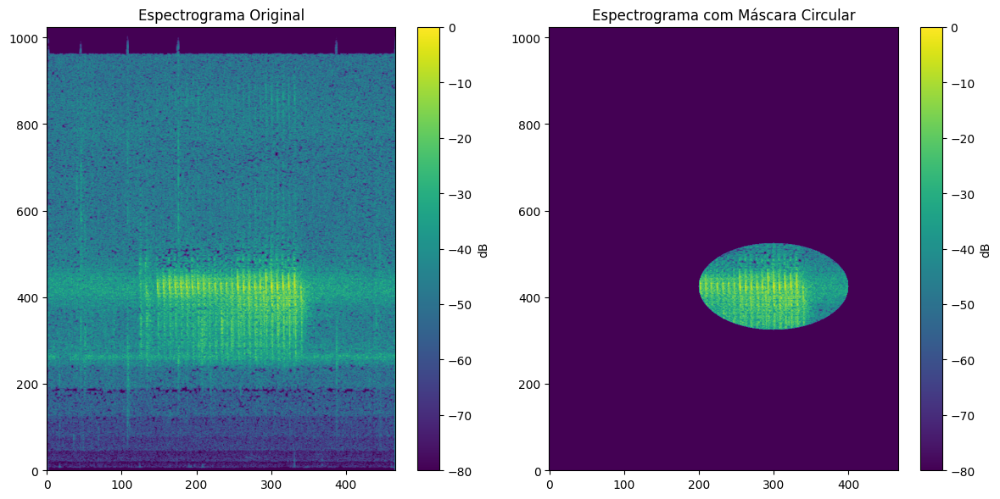

In [210]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio, display


def calculate_spectrograms(audio_files, center_audio=False, center_seconds=10):
    spectrograms = []

    y, sr = librosa.load(audio_files, sr=None)
    
    if center_audio:
        num_samples_center = min(center_seconds * sr, len(y))  # Garante que não ultrapasse o tamanho do áudio
        start_sample = (len(y) - num_samples_center) // 2
        end_sample = start_sample + num_samples_center
        y = y[start_sample:end_sample]
        D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
        spectrograms.append((y, sr, D))
    else:
        D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
        spectrograms.append((y, sr, D))
    
    return y, sr, D

def find_max_intensity_points(D, num_points=3, threshold=0):
    """Encontra os pontos de maior intensidade em um espectrograma."""
    max_intensity_points = []
    D_copy = D.copy()
    
    for _ in range(num_points):
        # Encontra o índice do ponto de máximo valor
        max_intensity_idx = np.unravel_index(np.argmax(D_copy), D_copy.shape)
        
        # Verificar se o valor máximo é maior que o threshold
        if D_copy[max_intensity_idx] > threshold:
            max_intensity_points.append([max_intensity_idx[1], max_intensity_idx[0]])
            
            # Remover o ponto encontrado para encontrar o próximo ponto de maior intensidade
            D_copy[max_intensity_idx] = 0
        else:
            break  # Interrompe a busca se não houver mais pontos acima do threshold
        
    return max_intensity_points


def create_circle_mask(shape, center, radius):
    """Cria uma máscara circular."""
    rows, cols = shape
    Y, X = np.ogrid[:rows, :cols]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y - center[1])**2)
    mask = dist_from_center <= radius
    return mask

def apply_circle_mask_to_spectrogram(D, circle_centers, circle_radius):
    """Aplica uma máscara circular ao espectrograma."""
    D_masked = np.full_like(D, -80)  # Inicializa com -80 dB
    
    for center in circle_centers:
        mask = create_circle_mask(D.shape, center, circle_radius)
        D_masked = np.where(mask, D, D_masked)
    
    return D_masked

def play_audio(y, sr):
    """Reproduz um sinal de áudio."""
    display(Audio(data=y, rate=sr))

def plot_spectrograms(D, D_masked):
    """Plota o espectrograma original e o espectrograma com a máscara."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title('Espectrograma Original')
    plt.imshow(D, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.subplot(1, 2, 2)
    plt.title('Espectrograma com Máscara Circular')
    plt.imshow(D_masked, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.tight_layout()
    plt.show()

# XC659312.ogg
# Caminho do arquivo de áudio
audio_file = '/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1/XC659312.ogg'


# Calcular o espectrograma
y,sr, D = calculate_spectrograms(audio_file)

# Encontrar os pontos de maior intensidade
circle_centers = find_max_intensity_points(D, num_points=10, threshold=-200)
print(circle_centers)
# Definir o raio do círculo
circle_radius = 100

# Aplicar a máscara circular
D_masked = apply_circle_mask_to_spectrogram(D, circle_centers, circle_radius)

# Reproduzir o áudio original
print("Áudio Original:")
play_audio(y, sr)

# Reproduzir o áudio com a máscara
y_masked = librosa.istft(librosa.db_to_amplitude(D_masked))
print("Áudio com Máscara:")
play_audio(y_masked, sr)

# Plotar os espectrogramas
plot_spectrograms(D, D_masked)


SyntaxError: invalid syntax (1050044623.py, line 1)

/tmp/ipykernel_91924/3981085853.py:20: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


[[300, 424], [296, 420], [292, 416], [288, 412], [284, 408], [280, 404], [276, 400], [272, 396], [268, 392], [264, 388], [260, 384], [256, 380], [252, 376], [248, 372], [244, 368], [240, 364], [236, 360], [232, 356], [228, 352], [224, 348], [220, 344], [216, 340], [212, 336], [208, 332], [204, 328], [200, 324], [196, 320], [192, 316], [188, 312], [184, 308], [180, 304], [176, 300], [172, 296], [168, 292], [164, 288], [160, 284], [156, 280], [152, 276], [148, 272], [144, 268], [140, 264], [136, 260], [132, 256], [128, 252], [124, 248], [120, 244], [116, 240], [112, 236], [108, 232], [104, 228], [100, 224], [96, 220], [92, 216], [88, 212], [84, 208], [80, 204], [76, 200], [72, 196], [68, 192], [64, 188], [60, 184], [56, 180], [52, 176], [48, 172], [44, 168], [40, 164], [36, 160], [32, 156], [28, 152], [24, 148], [20, 144], [16, 140], [12, 136], [8, 132], [4, 128], [0, 124], [0, 120], [0, 116], [0, 112], [0, 108], [0, 104], [0, 100], [0, 96], [0, 92], [0, 88], [0, 84], [0, 80], [0, 76], [

Áudio com Máscara:


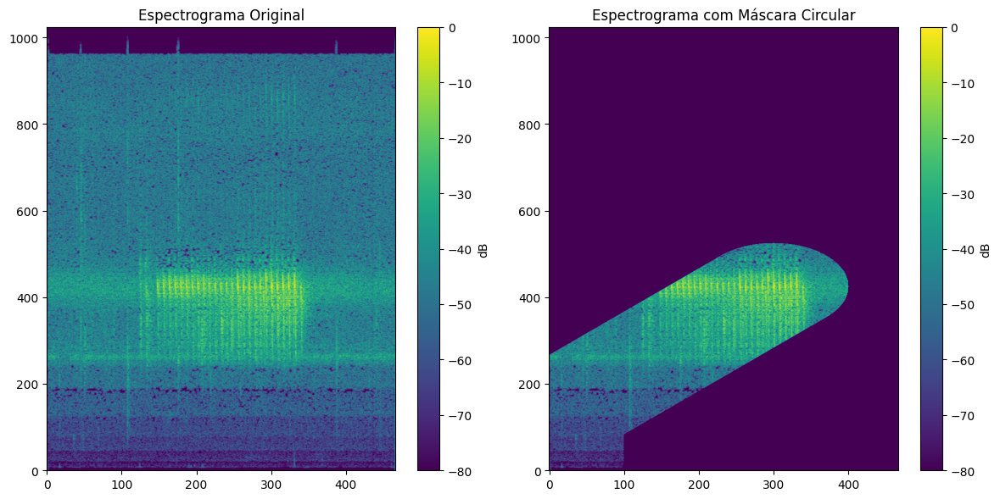

In [235]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio, display


def calculate_spectrograms(audio_files, center_audio=False, center_seconds=10):
    spectrograms = []

    y, sr = librosa.load(audio_files, sr=None)
    
    if center_audio:
        num_samples_center = min(center_seconds * sr, len(y))  # Garante que não ultrapasse o tamanho do áudio
        start_sample = (len(y) - num_samples_center) // 2
        end_sample = start_sample + num_samples_center
        y = y[start_sample:end_sample]
        D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
        spectrograms.append((y, sr, D))
    else:
        D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
        spectrograms.append((y, sr, D))
    
    return y, sr, D

def find_max_intensity_points(D, num_points=3, threshold=0, neighborhood=5):
    max_intensity_points = []
    D_copy = D.copy()
    
    for _ in range(num_points):
        max_intensity_idx = np.unravel_index(np.argmax(D_copy), D_copy.shape)
        
        if D_copy[max_intensity_idx] > threshold:
            max_intensity_points.append([max_intensity_idx[1], max_intensity_idx[0]])
            
            x, y = max_intensity_idx
            x_min, x_max = max(0, x - neighborhood), min(D_copy.shape[0], x + neighborhood)
            y_min, y_max = max(0, y - neighborhood), min(D_copy.shape[1], y + neighborhood)
            D_copy[x_min:x_max, y_min:y_max] = 0
        else:
            break
        
    return max_intensity_points
def create_circle_mask(shape, center, radius):
    """Cria uma máscara circular."""
    rows, cols = shape
    Y, X = np.ogrid[:rows, :cols]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y - center[1])**2)
    mask = dist_from_center <= radius
    return mask

def apply_circle_mask_to_spectrogram(D, circle_centers, circle_radius):
    """Aplica uma máscara circular ao espectrograma."""
    D_masked = np.full_like(D, -80)  # Inicializa com -80 dB
    
    for center in circle_centers:
        mask = create_circle_mask(D.shape, center, circle_radius)
        D_masked = np.where(mask, D, D_masked)
    
    return D_masked

def play_audio(y, sr):
    """Reproduz um sinal de áudio."""
    display(Audio(data=y, rate=sr))

def plot_spectrograms(D, D_masked):
    """Plota o espectrograma original e o espectrograma com a máscara."""
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title('Espectrograma Original')
    plt.imshow(D, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.subplot(1, 2, 2)
    plt.title('Espectrograma com Máscara Circular')
    plt.imshow(D_masked, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.tight_layout()
    plt.show()

# XC659312.ogg
# Caminho do arquivo de áudio
audio_file = '/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1/XC659312.ogg'


# Calcular o espectrograma
y,sr, D = calculate_spectrograms(audio_file)

# Encontrar os pontos de maior intensidade
circle_centers = find_max_intensity_points(D, num_points=100, threshold=-3, neighborhood=4)
print(circle_centers)
# Definir o raio do círculo
circle_radius = 100

# Aplicar a máscara circular
D_masked = apply_circle_mask_to_spectrogram(D, circle_centers, circle_radius)

# Reproduzir o áudio original
print("Áudio Original:")
play_audio(y, sr)

# Reproduzir o áudio com a máscara
y_masked = librosa.istft(librosa.db_to_amplitude(D_masked))
print("Áudio com Máscara:")
play_audio(y_masked, sr)

# Plotar os espectrogramas
plot_spectrograms(D, D_masked)

In [231]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio, display


def calculate_spectrograms(audio_files, center_audio=False, center_seconds=10):
    spectrograms = []

    y, sr = librosa.load(audio_files, sr=None)
    
    if center_audio:
        num_samples_center = min(center_seconds * sr, len(y))
        start_sample = (len(y) - num_samples_center) // 2
        end_sample = start_sample + num_samples_center
        y = y[start_sample:end_sample]
        D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
        spectrograms.append((y, sr, D))
    else:
        D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
        spectrograms.append((y, sr, D))
    
    return y, sr, D


def find_max_intensity_points(D, num_points=3, threshold=0, neighborhood=5):
    max_intensity_points = []
    D_copy = D.copy()
    
    for _ in range(num_points):
        max_intensity_idx = np.unravel_index(np.argmax(D_copy), D_copy.shape)
        
        if D_copy[max_intensity_idx] > threshold:
            max_intensity_points.append([max_intensity_idx[1], max_intensity_idx[0]])
            
            x, y = max_intensity_idx
            x_min, x_max = max(0, x - neighborhood), min(D_copy.shape[0], x + neighborhood)
            y_min, y_max = max(0, y - neighborhood), min(D_copy.shape[1], y + neighborhood)
            D_copy[x_min:x_max, y_min:y_max] = 0
        else:
            break
        
    return max_intensity_points


def create_circle_mask(shape, center, radius):
    rows, cols = shape
    Y, X = np.ogrid[:rows, :cols]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y - center[1])**2)
    mask = dist_from_center <= radius
    return mask


def apply_circle_mask_with_heatmap(D, D_heatmap, circle_radius):
    D_masked = np.full_like(D, -80)
    
    Y, X = np.ogrid[0:D.shape[0], 0:D.shape[1]]
    for x, y in np.argwhere(D_heatmap > 0):
        center = (y, x)
        mask = create_circle_mask(D.shape, center, circle_radius)
        D_masked[mask] = D[mask]
    
    return D_masked


def play_audio(y, sr):
    display(Audio(data=y, rate=sr))


def plot_spectrograms(D, D_masked):
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title('Espectrograma Original')
    plt.imshow(D, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.subplot(1, 2, 2)
    plt.title('Espectrograma com Máscara Circular')
    plt.imshow(D_masked, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.tight_layout()
    plt.show()


# Caminho do arquivo de áudio
audio_file = '/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1/XC659312.ogg'

# Calcular o espectrograma
y, sr, D = calculate_spectrograms(audio_file)

# Encontrar os pontos de maior intensidade
max_intensity_points = find_max_intensity_points(D, num_points=50, threshold=-3, neighborhood=4)
print(max_intensity_points)

# Aplicar o mapa de calor
D_heatmap = np.zeros_like(D)
for x, y in max_intensity_points:
    Y, X = np.ogrid[0:D.shape[0], 0:D.shape[1]]
    dist_from_center = np.sqrt((X - x)**2 + (Y - y)**2)
    weight = np.exp(-dist_from_center**2 / (2 * 5**2))
    D_heatmap = np.maximum(D_heatmap, weight)

# Definir o raio do círculo
circle_radius = 100

# Aplicar a máscara circular ponderada pelo mapa de calor
D_masked = apply_circle_mask_with_heatmap(D, D_heatmap, circle_radius)

# Reproduzir o áudio original
print("Áudio Original:")
play_audio(y, sr)

# Reproduzir o áudio com a máscara
y_masked = librosa.istft(librosa.db_to_amplitude(D_masked))
print("Áudio com Máscara:")
play_audio(y_masked, sr)

# Plotar os espectrogramas
plot_spectrograms(D, D_masked)


/tmp/ipykernel_91924/3863637610.py:20: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


[[300, 424], [296, 420], [292, 416], [288, 412], [284, 408], [280, 404], [276, 400], [272, 396], [268, 392], [264, 388], [260, 384], [256, 380], [252, 376], [248, 372], [244, 368], [240, 364], [236, 360], [232, 356], [228, 352], [224, 348], [220, 344], [216, 340], [212, 336], [208, 332], [204, 328], [200, 324], [196, 320], [192, 316], [188, 312], [184, 308], [180, 304], [176, 300], [172, 296], [168, 292], [164, 288], [160, 284], [156, 280], [152, 276], [148, 272], [144, 268], [140, 264], [136, 260], [132, 256], [128, 252], [124, 248], [120, 244], [116, 240], [112, 236], [108, 232], [104, 228]]


KeyboardInterrupt: 

In [233]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import Audio, display


def calculate_spectrograms(audio_files, center_audio=False, center_seconds=10):
    spectrograms = []

    y, sr = librosa.load(audio_files, sr=None)
    
    if center_audio:
        num_samples_center = min(center_seconds * sr, len(y))
        start_sample = (len(y) - num_samples_center) // 2
        end_sample = start_sample + num_samples_center
        y = y[start_sample:end_sample]
        D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
        spectrograms.append((y, sr, D))
    else:
        D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)
        spectrograms.append((y, sr, D))
    
    return y, sr, D


def find_max_intensity_points(D, num_points=3, threshold=0, neighborhood=5):
    max_intensity_points = []
    D_copy = D.copy()
    
    for _ in range(num_points):
        max_intensity_idx = np.unravel_index(np.argmax(D_copy), D_copy.shape)
        
        if D_copy[max_intensity_idx] > threshold:
            max_intensity_points.append([max_intensity_idx[1], max_intensity_idx[0]])
            
            x, y = max_intensity_idx
            x_min, x_max = max(0, x - neighborhood), min(D_copy.shape[0], x + neighborhood)
            y_min, y_max = max(0, y - neighborhood), min(D_copy.shape[1], y + neighborhood)
            D_copy[x_min:x_max, y_min:y_max] = 0
        else:
            break
        
    return max_intensity_points


def create_circle_mask(shape, center, radius):
    rows, cols = shape
    Y, X = np.ogrid[:rows, :cols]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y - center[1])**2)
    mask = dist_from_center <= radius
    return mask


def apply_circle_mask_with_heatmap(D, D_heatmap, circle_radius):
    D_masked = np.full_like(D, -80)
    
    for x, y in np.argwhere(D_heatmap > 0):
        center = (y, x)
        mask = create_circle_mask(D.shape, center, circle_radius)
        D_masked[mask] = D[mask]
    
    return D_masked


def play_audio(y, sr):
    display(Audio(data=y, rate=sr))


def plot_spectrograms(D, D_masked):
    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.title('Espectrograma Original')
    plt.imshow(D, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.subplot(1, 2, 2)
    plt.title('Espectrograma com Máscara Circular')
    plt.imshow(D_masked, aspect='auto', origin='lower', cmap='viridis')
    plt.colorbar(label='dB')

    plt.tight_layout()
    plt.show()


# Caminho do arquivo de áudio
audio_file = '/workspace/aimsbirdclef/input/birdclef-2024/train_audio/plaflo1/XC659312.ogg'

# Calcular o espectrograma
y, sr, D = calculate_spectrograms(audio_file)

# Encontrar os pontos de maior intensidade
max_intensity_points = find_max_intensity_points(D, num_points=50, threshold=-3, neighborhood=4)
print(max_intensity_points)

# Aplicar o mapa de calor
D_heatmap = np.zeros_like(D)
for x, y in max_intensity_points:
    Y, X = np.ogrid[0:D.shape[0], 0:D.shape[1]]
    dist_from_center = np.sqrt((X - x)**2 + (Y - y)**2)
    weight = np.exp(-dist_from_center**2 / (2 * 5**2))
    D_heatmap = np.maximum(D_heatmap, weight)

# Definir o raio do círculo
circle_radius = 100

# Aplicar a máscara circular ponderada pelo mapa de calor
D_masked = apply_circle_mask_with_heatmap(D, D_heatmap, circle_radius)

# Reproduzir o áudio original
print("Áudio Original:")
play_audio(y, sr)

# Reproduzir o áudio com a máscara
y_masked = librosa.istft(librosa.db_to_amplitude(D_masked))
print("Áudio com Máscara:")
play_audio(y_masked, sr)

# Plotar os espectrogramas
plot_spectrograms(D, D_masked)


/tmp/ipykernel_91924/3981521771.py:17: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  D = librosa.amplitude_to_db(librosa.stft(y), ref=np.max)


KeyboardInterrupt: 